In [1]:
import os
import torch
import numpy as np
import pandas as pd

import scanpy as sc
from anndata import AnnData

data_dir="../../data/NSCLC/processed1/"
result_dir = "../edges/"
raw_type=False
use_edge=False

In [2]:
import matplotlib.pyplot as plt
# Set global font sizes using rcParams
plt.rcParams.update({
    'font.size': 18,            # Global font size
    'axes.titlesize': 20,       # Font size of the axes title
    'axes.labelsize': 20,       # Font size of the x and y labels
    'xtick.labelsize': 16,      # Font size of the x-tick labels
    'ytick.labelsize': 16,      # Font size of the y-tick labels
    'legend.fontsize': 18,      # Font size of the legend
    'figure.titlesize': 24      # Font size of the figure title
})


In [3]:
gene_list = torch.load("/".join(data_dir.split("/")[:-2]) + "/genes.pth")
sample='Lung6'
top_genes=['SEC61G', 'S100A2', 'TYK2', 'HSP90AB1', 'KRT15', 'MALAT1', 'CD9', 'MTRNR2L1', 'HSPB1', 'GPNMB', 'KRT17', 'MIF', 'GSTP1', 'SPP1', 'KRT6A', 'RPL37', 'KRT19', 'EGFR', 'MZT2A', 'KRT5']
gene_list = torch.load("/".join(data_dir.split("/")[:-2]) + "/genes.pth")
str_x="CenterX_global_px"
str_y="CenterY_global_px"
str_cell_type="CellType"

In [4]:
def read_data(sample,idx,select=10,loss_threshold=10,normalize=False):
    results=torch.load(result_dir+"edges_"+sample+".pth",map_location=torch.device('cpu'))
    edges=results["edges"]

    # modify here
    if normalize:
        attention_score=torch.abs(results["attention_score"])/torch.sum(torch.abs(results["attention_score"]),dim=-2,keepdim=True)
    else:
        attention_score=results["attention_score"]
        normalized_attention_score=torch.abs(results["attention_score"])/torch.sum(torch.abs(results["attention_score"]),dim=-2,keepdim=True)
        
    position_x=results["position_x"]
    position_y=results["position_y"]
    cell_type_name=results["cell_type_name"]
    loss1=results["loss_all"].cpu()
    
    B,N=position_x.shape
    loss1=loss1.unsqueeze(dim=-1).repeat(1,select).reshape(-1).numpy()
    
    cell_type_target=[cell_type_name[i][0] for i in range(len(cell_type_name))]
    
    '''
    if normalize:
        indices=torch.topk(torch.sum(attention_score,dim=-1),k=select,dim=-1)[1]
        print(torch.topk(torch.mean(attention_score,dim=-1),k=select,dim=-1))
    else:
        tmp=torch.abs(results["attention_score"])/torch.sum(torch.abs(results["attention_score"]),dim=-2,keepdim=True)
        indices=torch.topk(torch.sum(tmp,dim=-1),k=select,dim=-1)[1]
        print(torch.topk(torch.mean(tmp,dim=-1),k=select,dim=-1))
    '''
    indices=torch.topk(attention_score[:,:,idx],k=select,dim=-1)[1]

    indices_tmp=torch.arange(0,indices.shape[0],1).unsqueeze(dim=-1).repeat(1,select)
    indices=torch.stack([indices_tmp.reshape(-1),indices.reshape(-1)],dim=0)

    if not use_edge:
        edge=attention_score
    edges=edge[indices[0],indices[1],:].reshape(-1,edge.shape[-1]).numpy()
    
    to_position_x=position_x[:,0:1].repeat(1,select).reshape(-1).numpy()
    to_position_y=position_y[:,0:1].repeat(1,select).reshape(-1).numpy()
    from_position_x=position_x[:,1:][indices[0],indices[1]].reshape(-1).numpy()
    from_position_y=position_y[:,1:][indices[0],indices[1]].reshape(-1).numpy()
    
    dx=position_x-position_x[:,0:1]
    dy=position_y-position_y[:,0:1]
    distances=torch.sqrt(torch.square(dx)+torch.square(dy))
    distances=distances[indices[0],indices[1]].reshape(-1).numpy()
    
    indices_np=indices.numpy()
    cell_types=np.array(cell_type_name)[:,1:][indices_np[0],indices_np[1]].reshape(B,select)
    cell_types_pair=[]
    flags=[]
    for i in range(cell_types.shape[0]):
        for j in range(cell_types.shape[1]):
            if not raw_type:
                cell_types_pair.append(cell_types[i][j]+"__"+cell_type_target[i])
                flags.append(cell_type_target[i]!=cell_types[i][j])
            else:
                cell_types_pair.append(cell_types[i][j].split(" ")[0]+"__"+cell_type_target[i].split(" ")[0])
                flags.append(cell_types[i][j].split(" ")[0]!=cell_type_target[i].split(" ")[0])
    print(edges.shape)
    adata = AnnData(edges)
    adata.obs['cell_type'] = cell_types_pair
    adata.obs['from_position_x'] = from_position_x
    adata.obs['from_position_y'] = from_position_y
    adata.obs['to_position_x'] = to_position_x
    adata.obs['to_position_y'] = to_position_y
    adata.obs['distance']=distances
    adata.obs['loss']=loss1
    
    adata=adata[(adata.obs['loss']<loss_threshold)&flags,:]
    return adata

def plot(adata,color='cell_type',select_type_number=None,select_type=None):
    assert not ((select_type is None and select_type_number is None) and (select_type is not None and select_type_number is not None))
    
    if select_type_number is not None:
        unique=np.unique(adata.obs['cell_type'],return_counts=True)
        args = np.argsort(-unique[1])[:select_type_number]
        select_type = unique[0][args]
    print("selecting edge types:", select_type)
    
    flag=[adata.obs['cell_type'][i] in select_type for i in range(adata.shape[0])]
    adata_filtered=adata[flag,:]
    
    sc.tl.pca(adata_filtered, n_comps=10)
    sc.pp.neighbors(adata_filtered)  # Compute the neighborhood graph
    sc.tl.umap(adata_filtered)  # Compute UMAP
    # Plot UMAP
    sc.pl.umap(adata_filtered, color=color)
    return adata

#adata=read_data('mouse1_slice201',select=5)
#print(adata)

In [5]:
dicts = {}
dicts['T CD8 memory'] = 'lymphocyte'
dicts['T CD8 naive'] = 'lymphocyte'
dicts['T CD4 naive'] = 'lymphocyte'
dicts['T CD4 memory'] = 'lymphocyte'
dicts['Treg'] = 'lymphocyte'
dicts['B-cell'] = 'lymphocyte'
dicts['plasmablast'] = 'lymphocyte'
dicts['NK'] = 'lymphocyte'
dicts['monocyte'] = 'Mcell' # Mcell is myeloid cell
dicts['macrophage'] = 'Mcell' 
dicts['mDC'] = 'Mcell'
dicts['pDC'] = 'Mcell'
# sigra did not have correct operations on tumors X types
dicts['tumor 9'] = 'tumors'
dicts['tumor 5'] = 'tumors'
dicts['tumor 6'] = 'tumors'
dicts['tumor 12'] = 'tumors'
dicts['tumor 13'] = 'tumors'
dicts['epithelial'] = 'epithelial'
dicts['mast'] = 'mast'
dicts['endothelial'] = 'endothelial'
dicts['fibroblast'] = 'fibroblast'
dicts['neutrophil'] = 'neutrophil'

In [6]:
def load_sample_position(sample):
    df = pd.read_csv(data_dir+sample+".csv")
    generalized_ct=[]
    for i in range(df.shape[0]):
        generalized_ct.append(dicts[df.loc[i,"CellType"]])
    df['generalized_ct']=generalized_ct
    return df

df_position=load_sample_position(sample)

(array(['B-cell', 'NK', 'T CD4 memory', 'T CD4 naive', 'T CD8 memory',
       'T CD8 naive', 'Treg', 'endothelial', 'epithelial', 'fibroblast',
       'mDC', 'macrophage', 'mast', 'monocyte', 'neutrophil', 'pDC',
       'plasmablast', 'tumor 12', 'tumor 13', 'tumor 5', 'tumor 6',
       'tumor 9'], dtype=object), array([  486,   184,   614,   503,   539,   689,   319,  2581,  4119,
        3249,   904,  6879,   254,   296,   482,   470,   409,   475,
         196,    60, 66186,    54]))


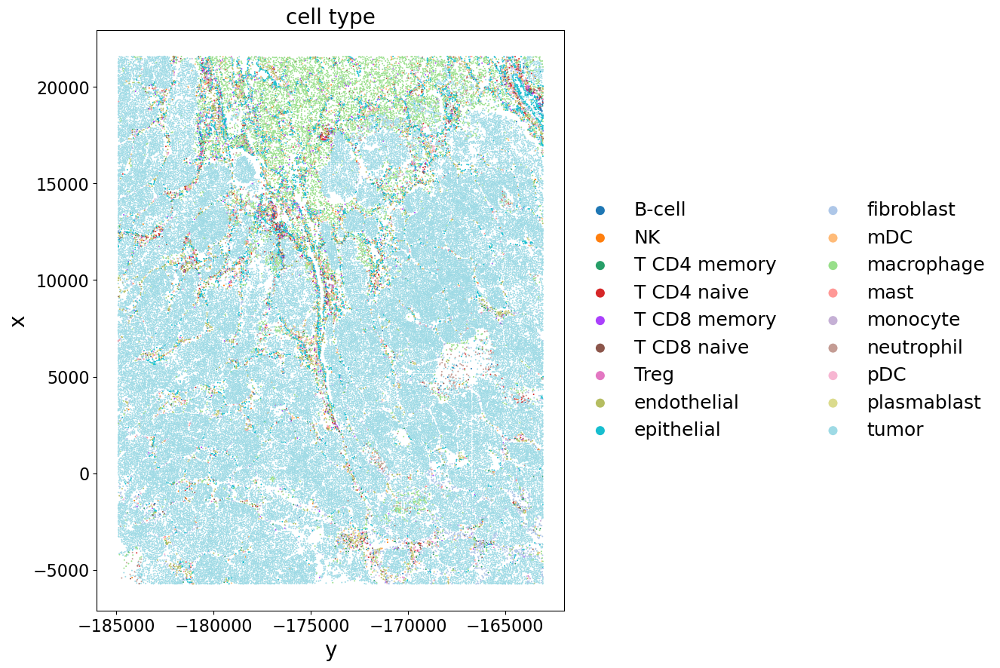

In [7]:
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.colors as mcolors
import matplotlib.lines as mlines
import matplotlib as mpl

# Set the colormap using rcParams
color_map=None
#mpl.rcParams['image.cmap'] = 'plasma'

def plot_type(df):
    """
    Plots a scatter plot for a DataFrame with discrete 'loss_all' values.

    Parameters:
    df (DataFrame): Pandas DataFrame with columns 'loss_all', 'position_x', 'position_y'
    """
    adata=AnnData(X=np.zeros((df.shape[0],3)))
    adata.obs["x"]=df["CenterX_global_px"].values
    adata.obs["y"]=df["CenterY_global_px"].values
    adata.obs['generalized_ct']=df['generalized_ct'].values

    cell_types=np.array(df["CellType"].values)
    print(np.unique(cell_types,return_counts=True))
    cell_types=[x.split(" ")[0] if x.find("tumor")>=0 else x for x in cell_types]
    
    adata.obs["cell_type"]=cell_types
    fig, ax = plt.subplots(figsize=(8, 10))
    sc.pl.scatter(
        adata,
        x='y',#'position_x',
        y='x',#'position_y',
        color="cell_type",ax=ax,size=8#,palette='Set2',
    )
    '''
    # Create the scatter plot
    #plt.figure(figsize=(12, 8))
    scatter = sns.scatterplot(data=df, x="CenterX_global_px", y="CenterY_global_px", hue='generalized_ct', legend='full')#'generalized_ct'#"CellType"

    # Customizing the plot
    plt.title('Discrete Loss Visualization According to Position')
    plt.xlabel('Position X')
    plt.ylabel('Position Y')
    plt.legend(title='Cell_type')

    # Display the plot
    plt.show()
    '''

plot_type(df_position)

In [8]:
import matplotlib.pyplot as plt
import numpy as np
def plot_info_flow(sample,df_position,idx,title,cutoff=0.05,cutoff_type="percentage",select=5):
    adata=read_data(sample,idx,select=select)
    from_x = adata.obs['from_position_x']
    from_y = adata.obs['from_position_y']
    to_x = adata.obs['to_position_x']
    to_y = adata.obs['to_position_y']
    values = adata.X[:, idx]

    flag = [values[i] >= cutoff for i in range(values.shape[0])]
    if cutoff_type=="percentage":
        retain_number=int(values.shape[0]*cutoff)
        args=np.argsort(-values)[:retain_number]
        flag=[i for i in range(values.shape[0]) if i in args.tolist()]
    from_x = from_x[flag]
    from_y = from_y[flag]
    to_x = to_x[flag]
    to_y = to_y[flag]
    values = values[flag]

    # Calculate differences for arrow directions
    dx = to_x - from_x
    dy = to_y - from_y

    # Normalize the values for coloring
    norm = plt.Normalize(values.min(), values.max())

    # Create a colormap
    cmap = plt.cm.jet

    # Create a figure
    width=np.max(df_position.loc[:,str_x])-np.min(df_position.loc[:,str_x])
    height=np.max(df_position.loc[:,str_y])-np.min(df_position.loc[:,str_y])
    fig, ax = plt.subplots(figsize=(10*(width/height+0.25), 10))
    
    # Plotting the arrows using quiver
    scatter = sns.scatterplot(data=df_position, x=str_x, y=str_y, hue='CellType', legend='full',ax=ax,size=0.1)
    # Move the legend to the upper left corner
    ax.legend(loc='upper left')
    quiver = ax.quiver(from_x, from_y, dx, dy, values, angles='xy', scale_units='xy', scale=1, cmap=cmap, norm=norm)
    
    # Set the x and y axis limits
    min_x_value=min(np.min(adata.obs['from_position_x']),np.min(adata.obs['to_position_x']))
    min_y_value=min(np.min(adata.obs['from_position_y']),np.min(adata.obs['to_position_y']))
    max_x_value=max(np.max(adata.obs['from_position_x']),np.max(adata.obs['to_position_x']))
    max_y_value=max(np.max(adata.obs['from_position_y']),np.max(adata.obs['to_position_y']))
    ax.set_xlim([min_x_value, max_x_value])  # Replace with your desired limits
    ax.set_ylim([min_y_value, max_y_value])  # Replace with your desired limits
    
    # Show color bar
    sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
    sm.set_array([])
    fig.colorbar(sm, ax=ax)

    # Show the plot
    plt.title(title)
    plt.show()

(445455, 960)


/tmp/ipykernel_4030282/4075740587.py:72: FutureWarning: Logical ops (and, or, xor) between Pandas objects and dtype-less sequences (e.g. list, tuple) are deprecated and will raise in a future version. Wrap the object in a Series, Index, or np.array before operating instead.
  adata=adata[(adata.obs['loss']<loss_threshold)&flags,:]
/tmp/ipykernel_4030282/862913190.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  from_x = from_x[flag]
/tmp/ipykernel_4030282/862913190.py:17: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  from_y = from_y[flag]
/tmp/ipykernel_4030282/862913190.py:18: FutureWarning: Series.__getitem__ t

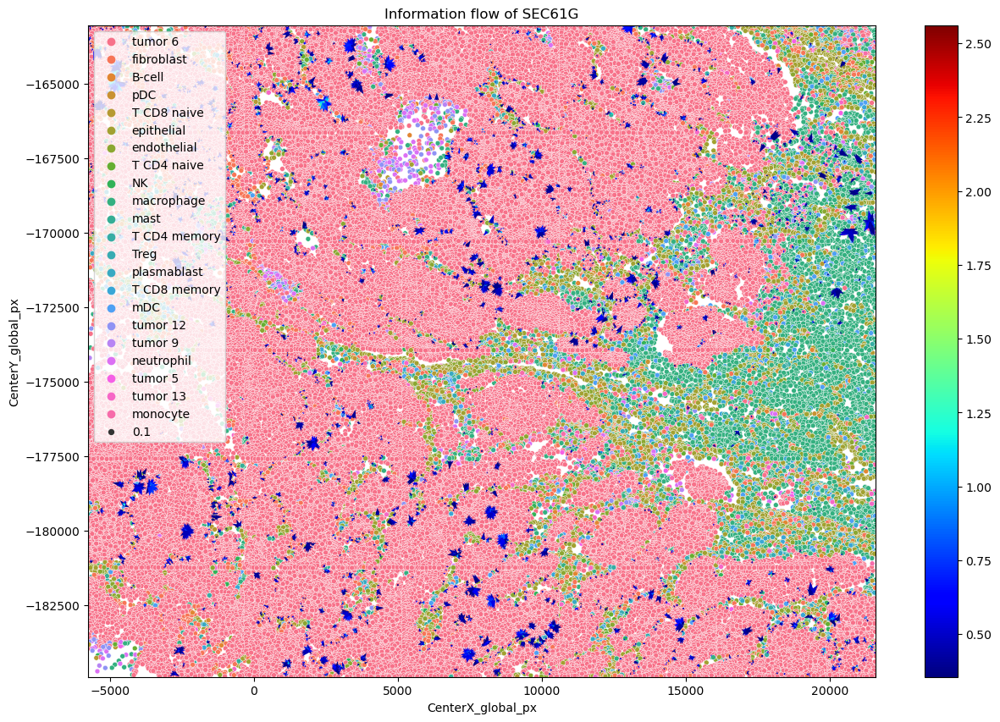

(445455, 960)


/tmp/ipykernel_4030282/4075740587.py:72: FutureWarning: Logical ops (and, or, xor) between Pandas objects and dtype-less sequences (e.g. list, tuple) are deprecated and will raise in a future version. Wrap the object in a Series, Index, or np.array before operating instead.
  adata=adata[(adata.obs['loss']<loss_threshold)&flags,:]
/tmp/ipykernel_4030282/862913190.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  from_x = from_x[flag]
/tmp/ipykernel_4030282/862913190.py:17: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  from_y = from_y[flag]
/tmp/ipykernel_4030282/862913190.py:18: FutureWarning: Series.__getitem__ t

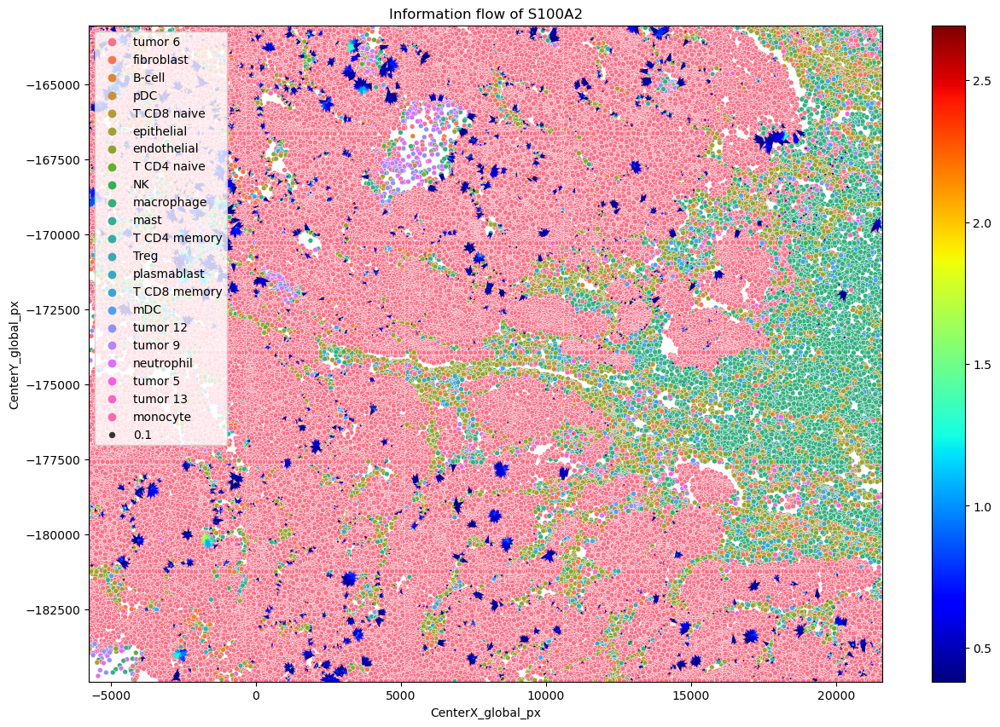

(445455, 960)


/tmp/ipykernel_4030282/4075740587.py:72: FutureWarning: Logical ops (and, or, xor) between Pandas objects and dtype-less sequences (e.g. list, tuple) are deprecated and will raise in a future version. Wrap the object in a Series, Index, or np.array before operating instead.
  adata=adata[(adata.obs['loss']<loss_threshold)&flags,:]
/tmp/ipykernel_4030282/862913190.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  from_x = from_x[flag]
/tmp/ipykernel_4030282/862913190.py:17: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  from_y = from_y[flag]
/tmp/ipykernel_4030282/862913190.py:18: FutureWarning: Series.__getitem__ t

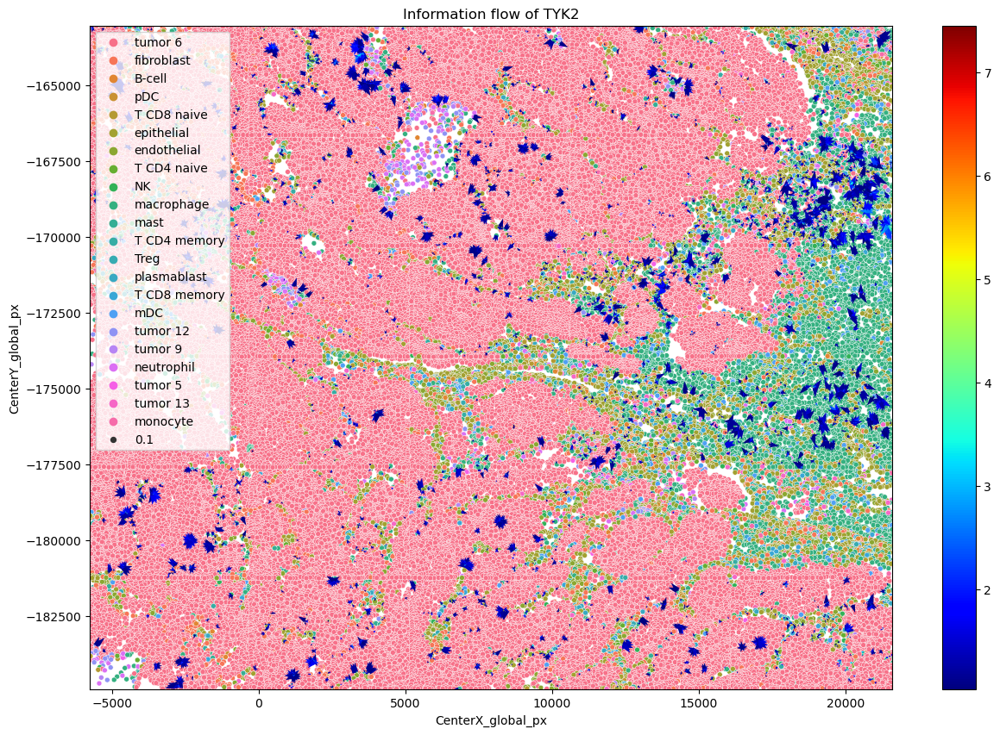

(445455, 960)


/tmp/ipykernel_4030282/4075740587.py:72: FutureWarning: Logical ops (and, or, xor) between Pandas objects and dtype-less sequences (e.g. list, tuple) are deprecated and will raise in a future version. Wrap the object in a Series, Index, or np.array before operating instead.
  adata=adata[(adata.obs['loss']<loss_threshold)&flags,:]
/tmp/ipykernel_4030282/862913190.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  from_x = from_x[flag]
/tmp/ipykernel_4030282/862913190.py:17: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  from_y = from_y[flag]
/tmp/ipykernel_4030282/862913190.py:18: FutureWarning: Series.__getitem__ t

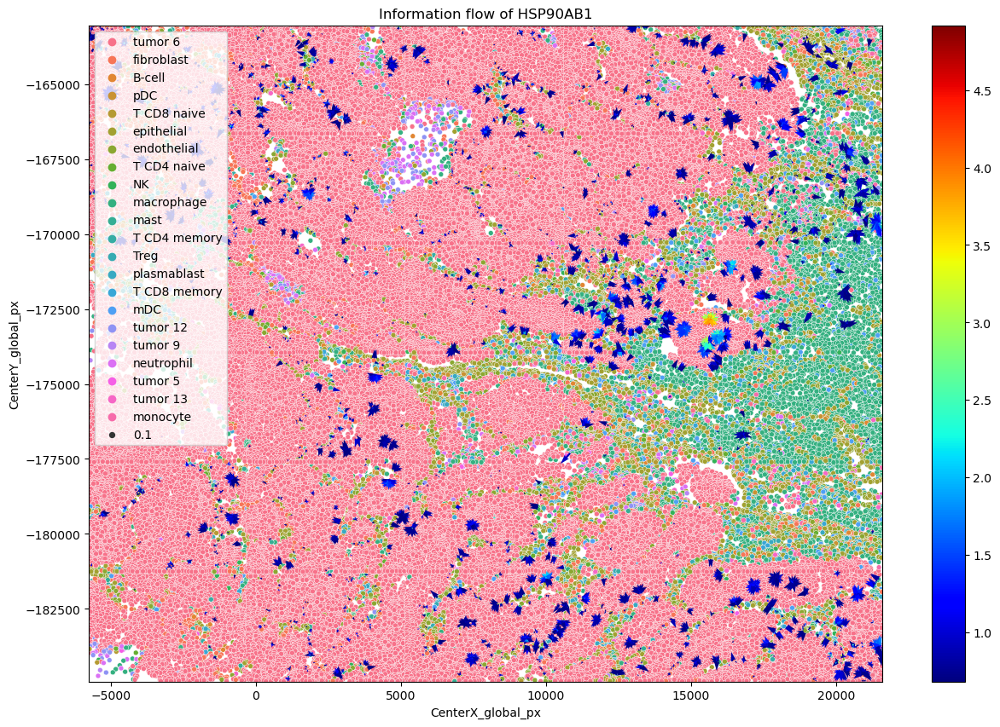

(445455, 960)


/tmp/ipykernel_4030282/4075740587.py:72: FutureWarning: Logical ops (and, or, xor) between Pandas objects and dtype-less sequences (e.g. list, tuple) are deprecated and will raise in a future version. Wrap the object in a Series, Index, or np.array before operating instead.
  adata=adata[(adata.obs['loss']<loss_threshold)&flags,:]
/tmp/ipykernel_4030282/862913190.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  from_x = from_x[flag]
/tmp/ipykernel_4030282/862913190.py:17: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  from_y = from_y[flag]
/tmp/ipykernel_4030282/862913190.py:18: FutureWarning: Series.__getitem__ t

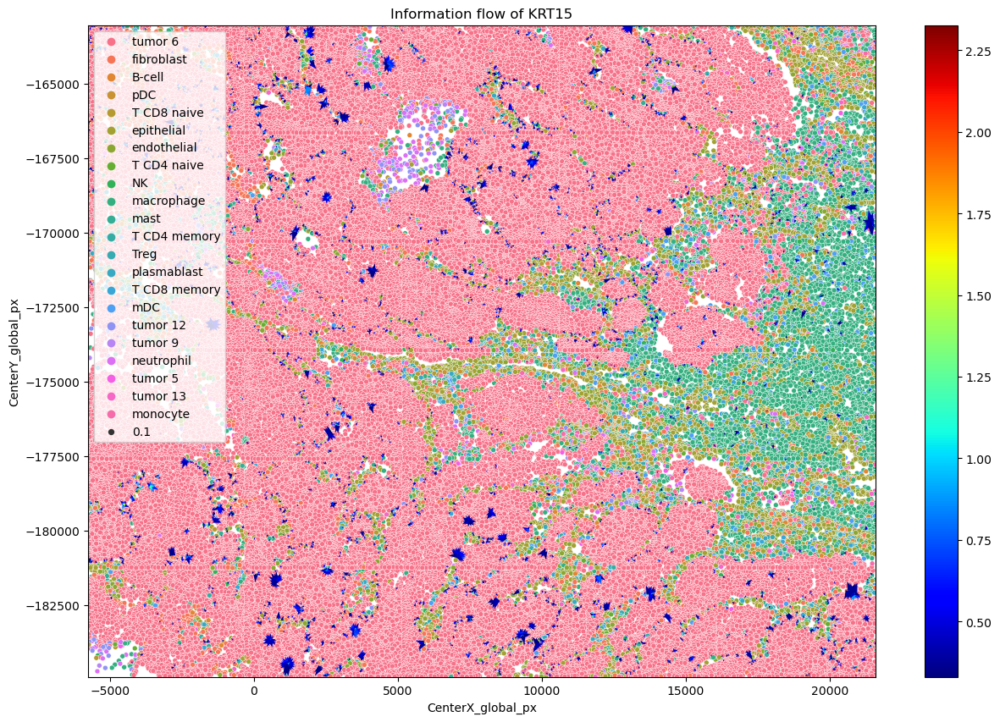

(445455, 960)


/tmp/ipykernel_4030282/4075740587.py:72: FutureWarning: Logical ops (and, or, xor) between Pandas objects and dtype-less sequences (e.g. list, tuple) are deprecated and will raise in a future version. Wrap the object in a Series, Index, or np.array before operating instead.
  adata=adata[(adata.obs['loss']<loss_threshold)&flags,:]
/tmp/ipykernel_4030282/862913190.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  from_x = from_x[flag]
/tmp/ipykernel_4030282/862913190.py:17: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  from_y = from_y[flag]
/tmp/ipykernel_4030282/862913190.py:18: FutureWarning: Series.__getitem__ t

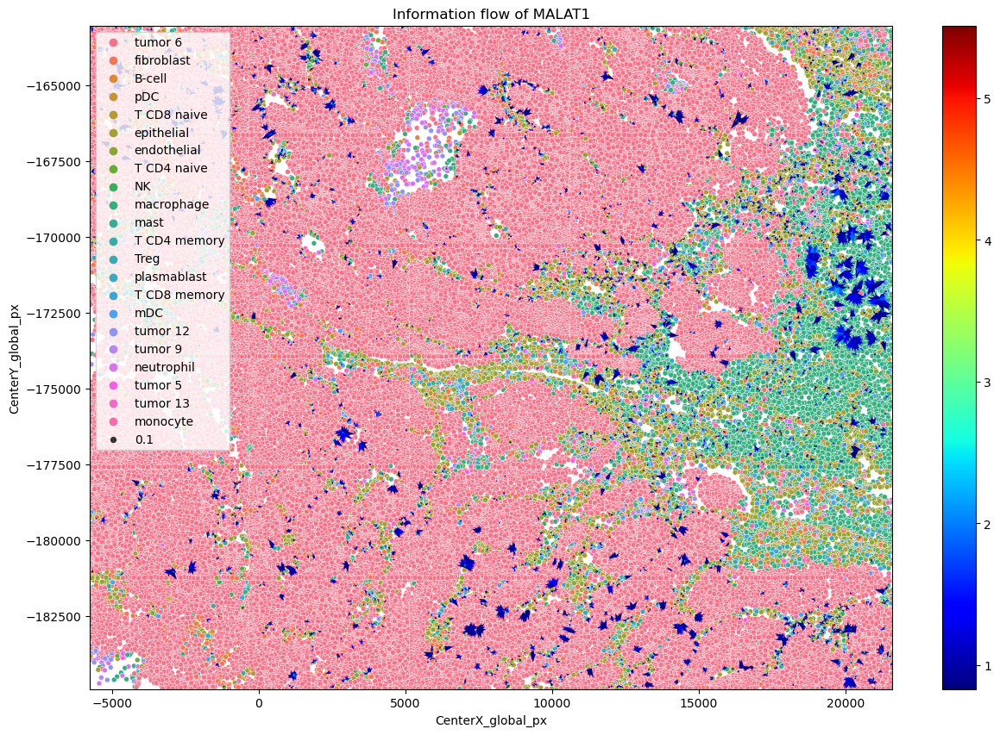

(445455, 960)


/tmp/ipykernel_4030282/4075740587.py:72: FutureWarning: Logical ops (and, or, xor) between Pandas objects and dtype-less sequences (e.g. list, tuple) are deprecated and will raise in a future version. Wrap the object in a Series, Index, or np.array before operating instead.
  adata=adata[(adata.obs['loss']<loss_threshold)&flags,:]
/tmp/ipykernel_4030282/862913190.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  from_x = from_x[flag]
/tmp/ipykernel_4030282/862913190.py:17: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  from_y = from_y[flag]
/tmp/ipykernel_4030282/862913190.py:18: FutureWarning: Series.__getitem__ t

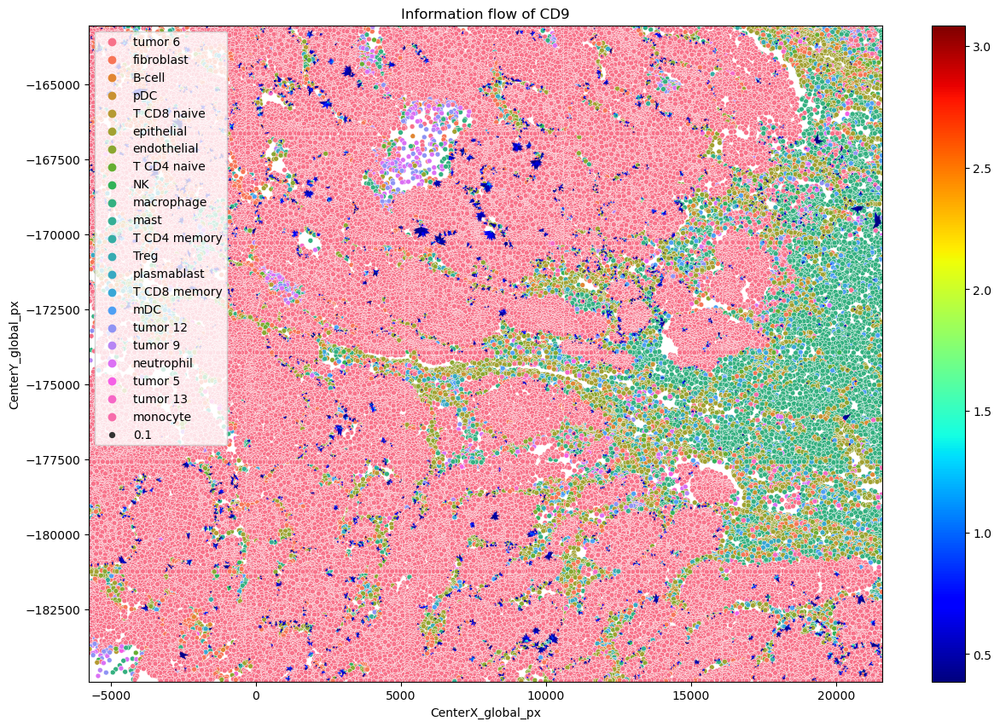

(445455, 960)


/tmp/ipykernel_4030282/4075740587.py:72: FutureWarning: Logical ops (and, or, xor) between Pandas objects and dtype-less sequences (e.g. list, tuple) are deprecated and will raise in a future version. Wrap the object in a Series, Index, or np.array before operating instead.
  adata=adata[(adata.obs['loss']<loss_threshold)&flags,:]
/tmp/ipykernel_4030282/862913190.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  from_x = from_x[flag]
/tmp/ipykernel_4030282/862913190.py:17: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  from_y = from_y[flag]
/tmp/ipykernel_4030282/862913190.py:18: FutureWarning: Series.__getitem__ t

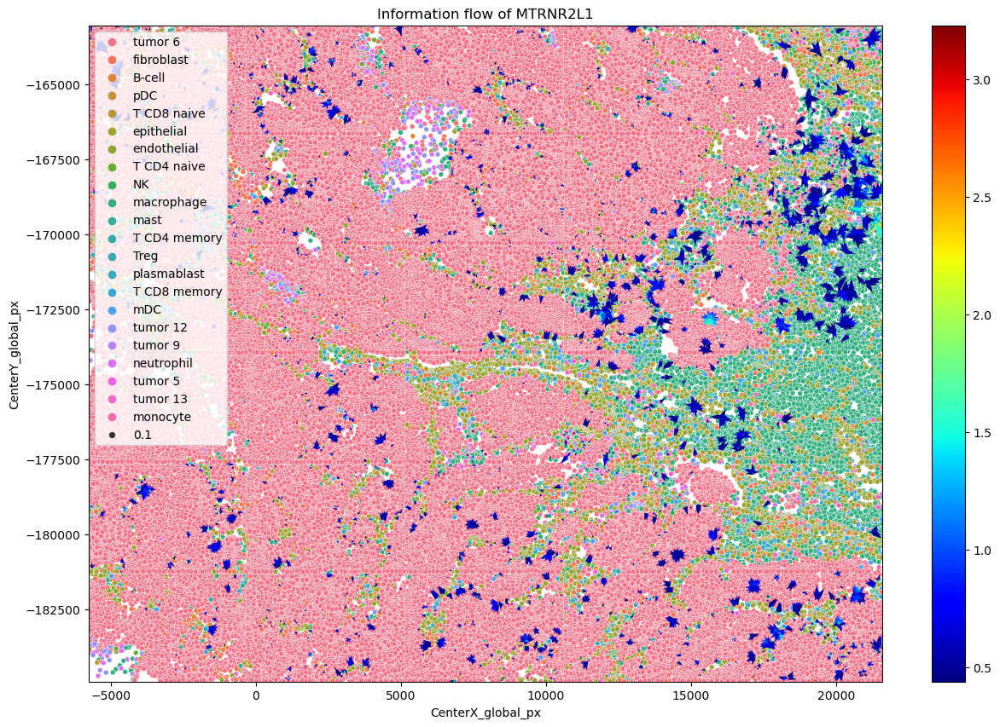

(445455, 960)


/tmp/ipykernel_4030282/4075740587.py:72: FutureWarning: Logical ops (and, or, xor) between Pandas objects and dtype-less sequences (e.g. list, tuple) are deprecated and will raise in a future version. Wrap the object in a Series, Index, or np.array before operating instead.
  adata=adata[(adata.obs['loss']<loss_threshold)&flags,:]
/tmp/ipykernel_4030282/862913190.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  from_x = from_x[flag]
/tmp/ipykernel_4030282/862913190.py:17: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  from_y = from_y[flag]
/tmp/ipykernel_4030282/862913190.py:18: FutureWarning: Series.__getitem__ t

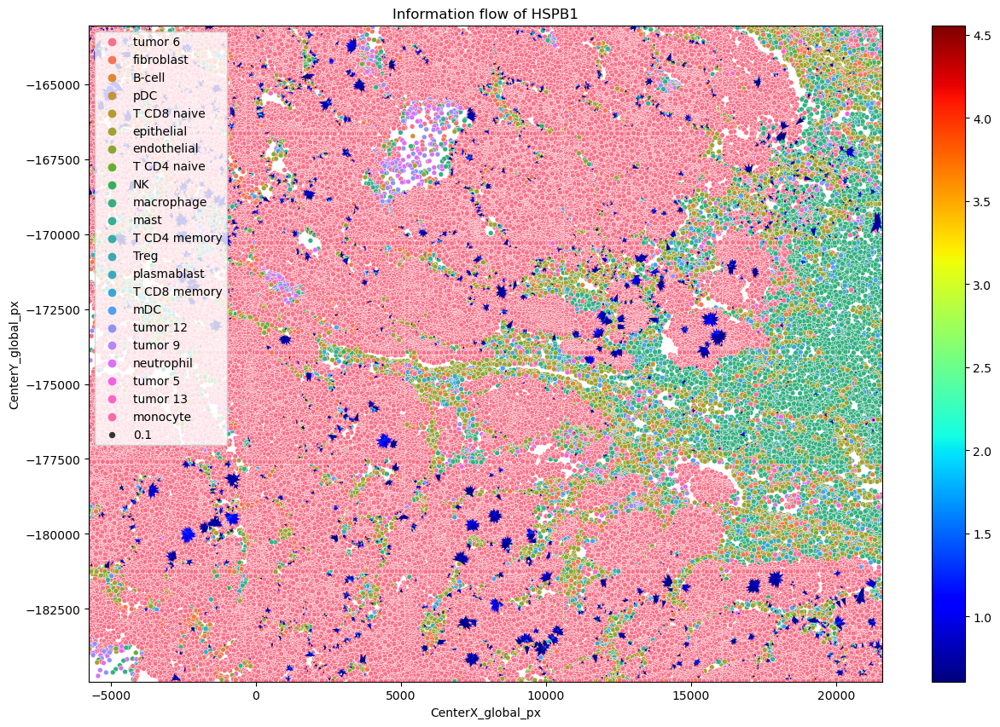

(445455, 960)


/tmp/ipykernel_4030282/4075740587.py:72: FutureWarning: Logical ops (and, or, xor) between Pandas objects and dtype-less sequences (e.g. list, tuple) are deprecated and will raise in a future version. Wrap the object in a Series, Index, or np.array before operating instead.
  adata=adata[(adata.obs['loss']<loss_threshold)&flags,:]
/tmp/ipykernel_4030282/862913190.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  from_x = from_x[flag]
/tmp/ipykernel_4030282/862913190.py:17: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  from_y = from_y[flag]
/tmp/ipykernel_4030282/862913190.py:18: FutureWarning: Series.__getitem__ t

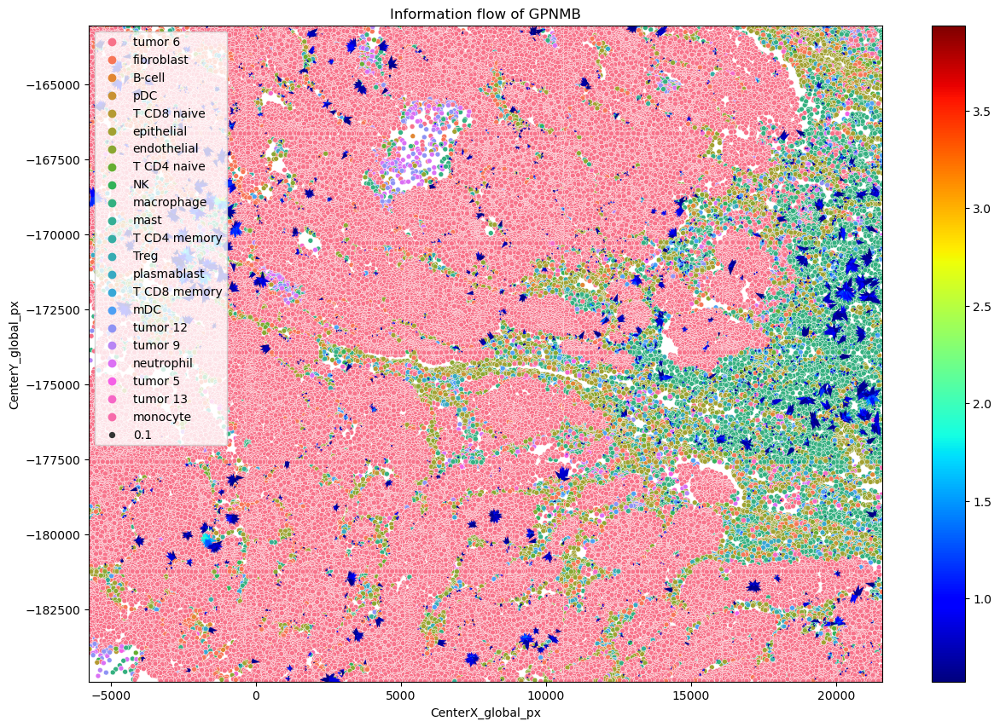

(445455, 960)


/tmp/ipykernel_4030282/4075740587.py:72: FutureWarning: Logical ops (and, or, xor) between Pandas objects and dtype-less sequences (e.g. list, tuple) are deprecated and will raise in a future version. Wrap the object in a Series, Index, or np.array before operating instead.
  adata=adata[(adata.obs['loss']<loss_threshold)&flags,:]
/tmp/ipykernel_4030282/862913190.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  from_x = from_x[flag]
/tmp/ipykernel_4030282/862913190.py:17: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  from_y = from_y[flag]
/tmp/ipykernel_4030282/862913190.py:18: FutureWarning: Series.__getitem__ t

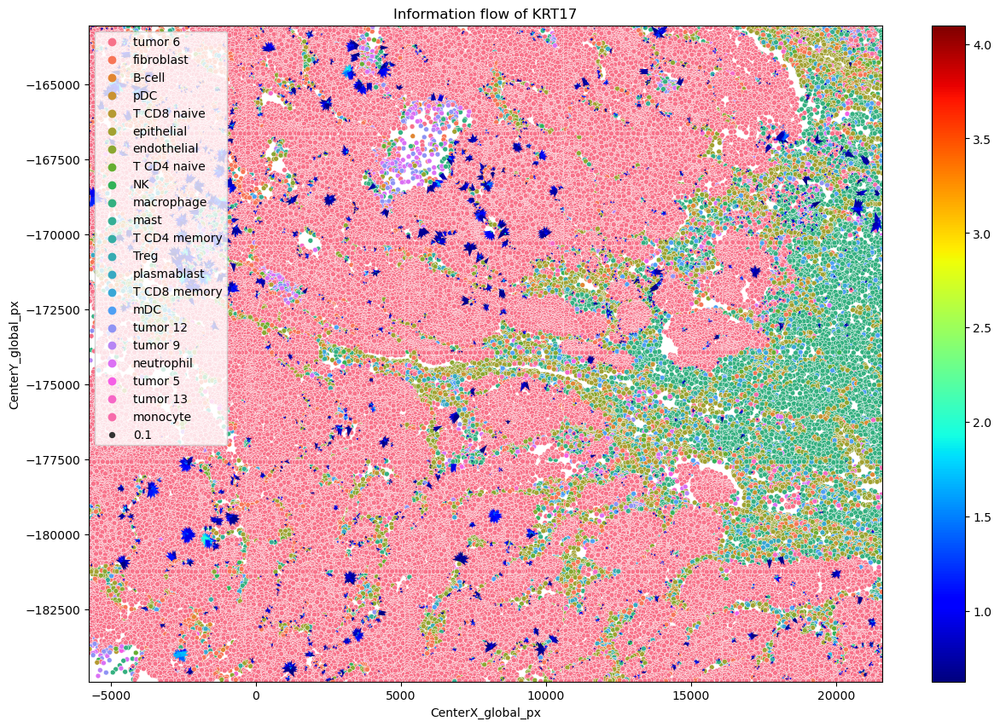

(445455, 960)


/tmp/ipykernel_4030282/4075740587.py:72: FutureWarning: Logical ops (and, or, xor) between Pandas objects and dtype-less sequences (e.g. list, tuple) are deprecated and will raise in a future version. Wrap the object in a Series, Index, or np.array before operating instead.
  adata=adata[(adata.obs['loss']<loss_threshold)&flags,:]
/tmp/ipykernel_4030282/862913190.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  from_x = from_x[flag]
/tmp/ipykernel_4030282/862913190.py:17: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  from_y = from_y[flag]
/tmp/ipykernel_4030282/862913190.py:18: FutureWarning: Series.__getitem__ t

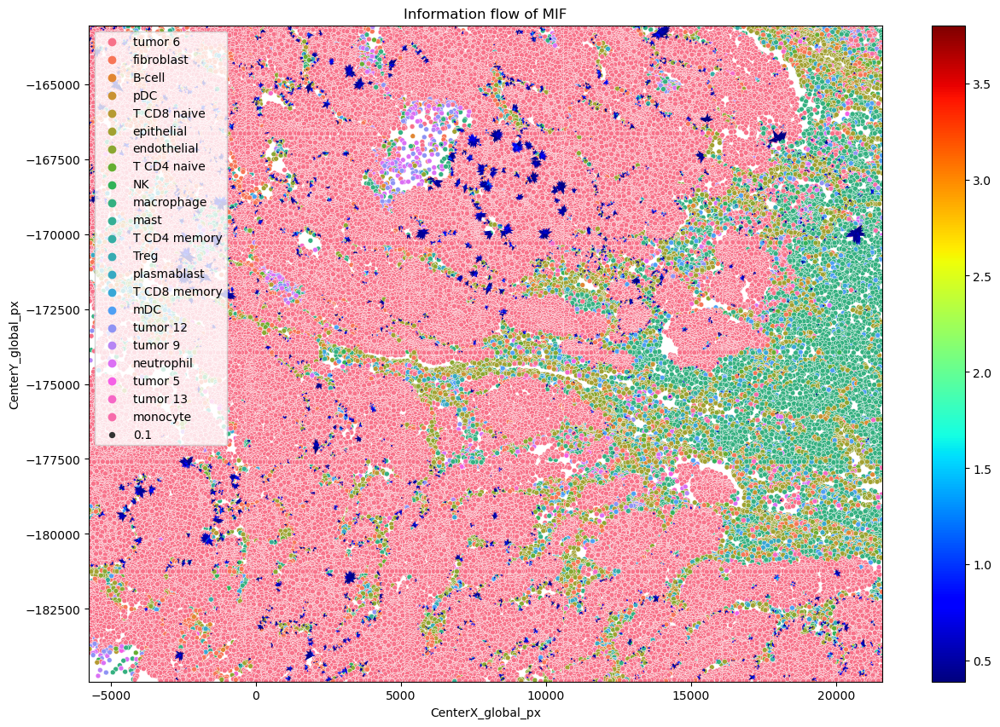

(445455, 960)


/tmp/ipykernel_4030282/4075740587.py:72: FutureWarning: Logical ops (and, or, xor) between Pandas objects and dtype-less sequences (e.g. list, tuple) are deprecated and will raise in a future version. Wrap the object in a Series, Index, or np.array before operating instead.
  adata=adata[(adata.obs['loss']<loss_threshold)&flags,:]
/tmp/ipykernel_4030282/862913190.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  from_x = from_x[flag]
/tmp/ipykernel_4030282/862913190.py:17: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  from_y = from_y[flag]
/tmp/ipykernel_4030282/862913190.py:18: FutureWarning: Series.__getitem__ t

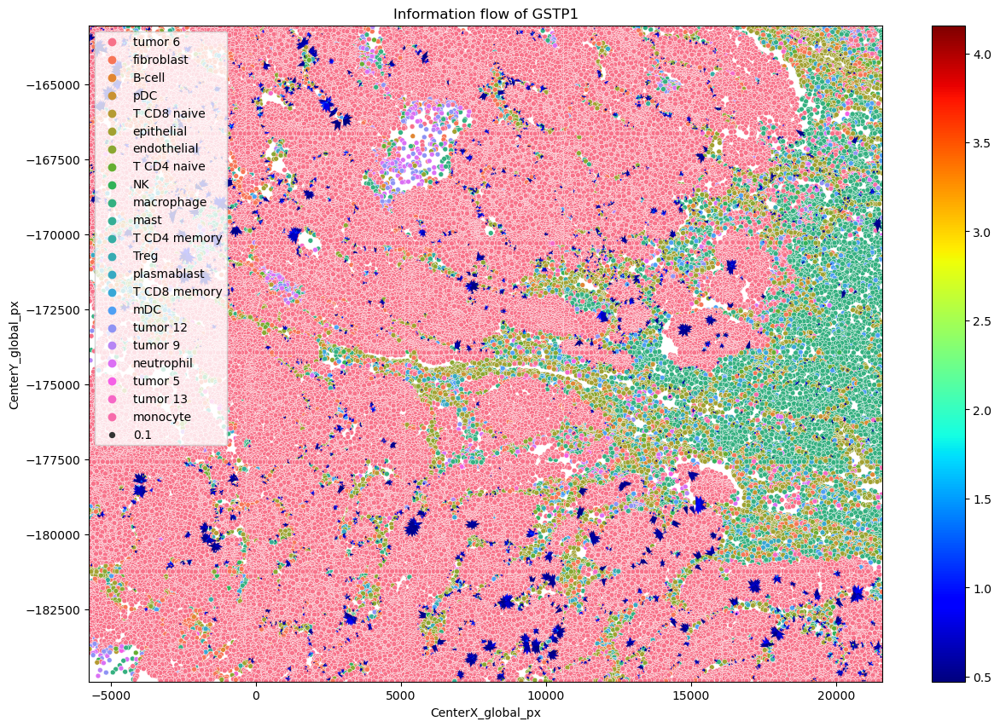

(445455, 960)


/tmp/ipykernel_4030282/4075740587.py:72: FutureWarning: Logical ops (and, or, xor) between Pandas objects and dtype-less sequences (e.g. list, tuple) are deprecated and will raise in a future version. Wrap the object in a Series, Index, or np.array before operating instead.
  adata=adata[(adata.obs['loss']<loss_threshold)&flags,:]
/tmp/ipykernel_4030282/862913190.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  from_x = from_x[flag]
/tmp/ipykernel_4030282/862913190.py:17: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  from_y = from_y[flag]
/tmp/ipykernel_4030282/862913190.py:18: FutureWarning: Series.__getitem__ t

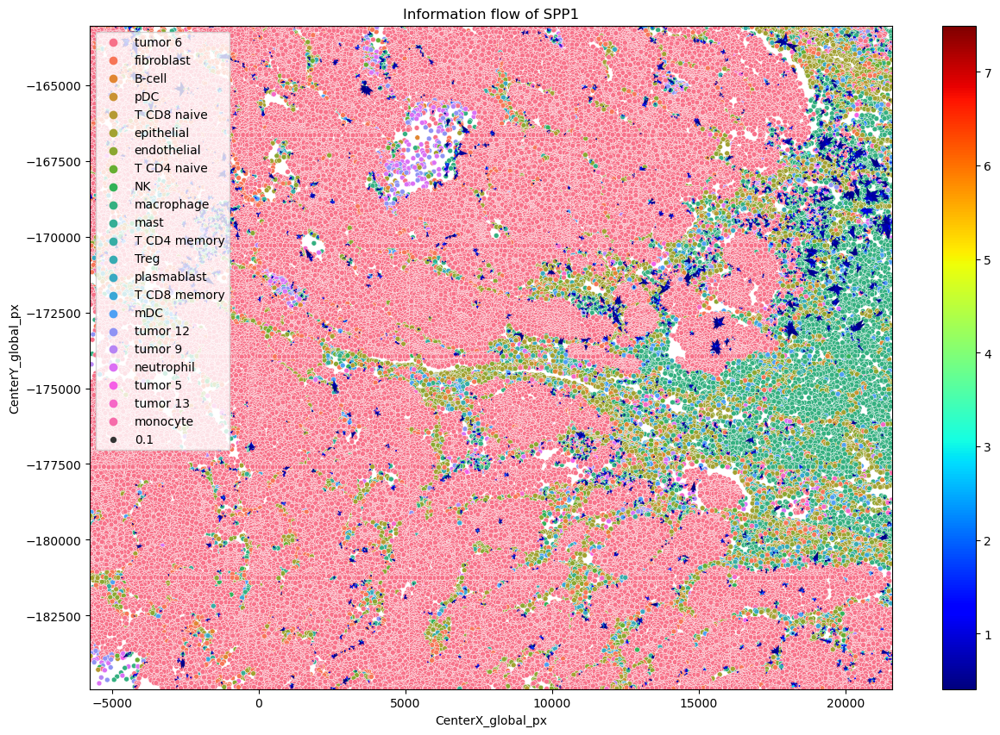

(445455, 960)


/tmp/ipykernel_4030282/4075740587.py:72: FutureWarning: Logical ops (and, or, xor) between Pandas objects and dtype-less sequences (e.g. list, tuple) are deprecated and will raise in a future version. Wrap the object in a Series, Index, or np.array before operating instead.
  adata=adata[(adata.obs['loss']<loss_threshold)&flags,:]
/tmp/ipykernel_4030282/862913190.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  from_x = from_x[flag]
/tmp/ipykernel_4030282/862913190.py:17: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  from_y = from_y[flag]
/tmp/ipykernel_4030282/862913190.py:18: FutureWarning: Series.__getitem__ t

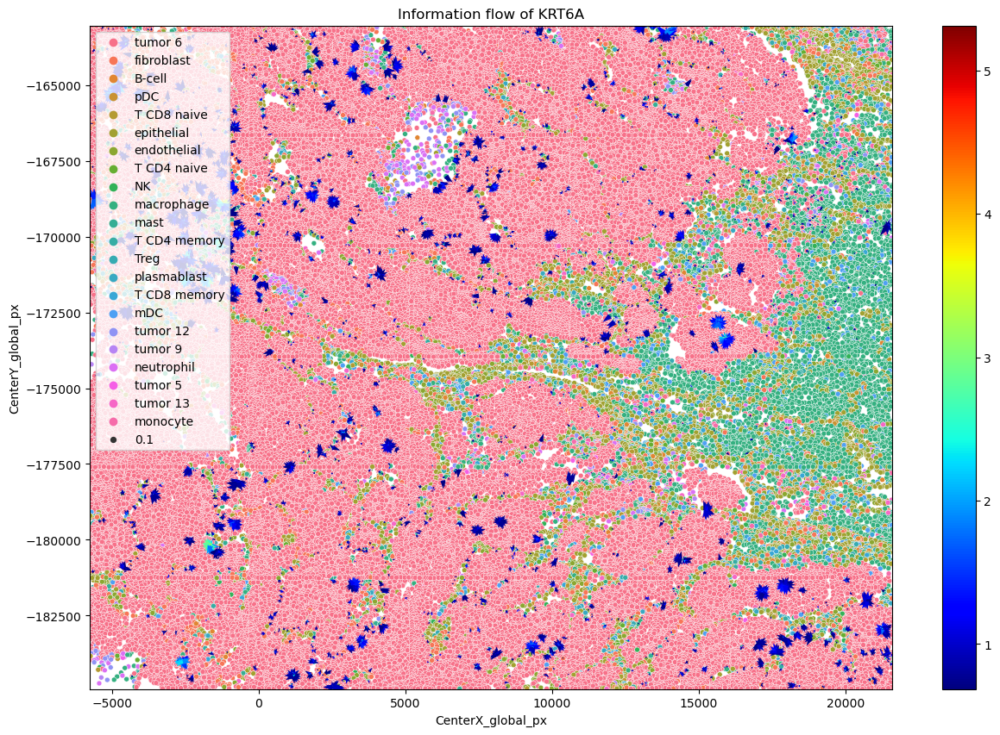

(445455, 960)


/tmp/ipykernel_4030282/4075740587.py:72: FutureWarning: Logical ops (and, or, xor) between Pandas objects and dtype-less sequences (e.g. list, tuple) are deprecated and will raise in a future version. Wrap the object in a Series, Index, or np.array before operating instead.
  adata=adata[(adata.obs['loss']<loss_threshold)&flags,:]
/tmp/ipykernel_4030282/862913190.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  from_x = from_x[flag]
/tmp/ipykernel_4030282/862913190.py:17: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  from_y = from_y[flag]
/tmp/ipykernel_4030282/862913190.py:18: FutureWarning: Series.__getitem__ t

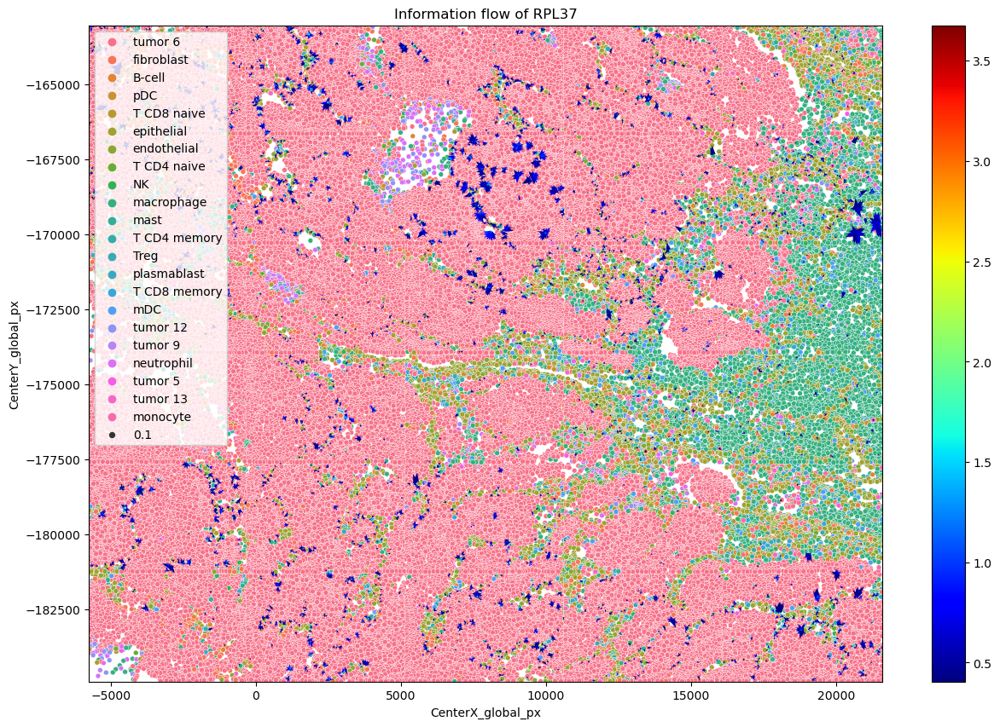

(445455, 960)


/tmp/ipykernel_4030282/4075740587.py:72: FutureWarning: Logical ops (and, or, xor) between Pandas objects and dtype-less sequences (e.g. list, tuple) are deprecated and will raise in a future version. Wrap the object in a Series, Index, or np.array before operating instead.
  adata=adata[(adata.obs['loss']<loss_threshold)&flags,:]
/tmp/ipykernel_4030282/862913190.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  from_x = from_x[flag]
/tmp/ipykernel_4030282/862913190.py:17: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  from_y = from_y[flag]
/tmp/ipykernel_4030282/862913190.py:18: FutureWarning: Series.__getitem__ t

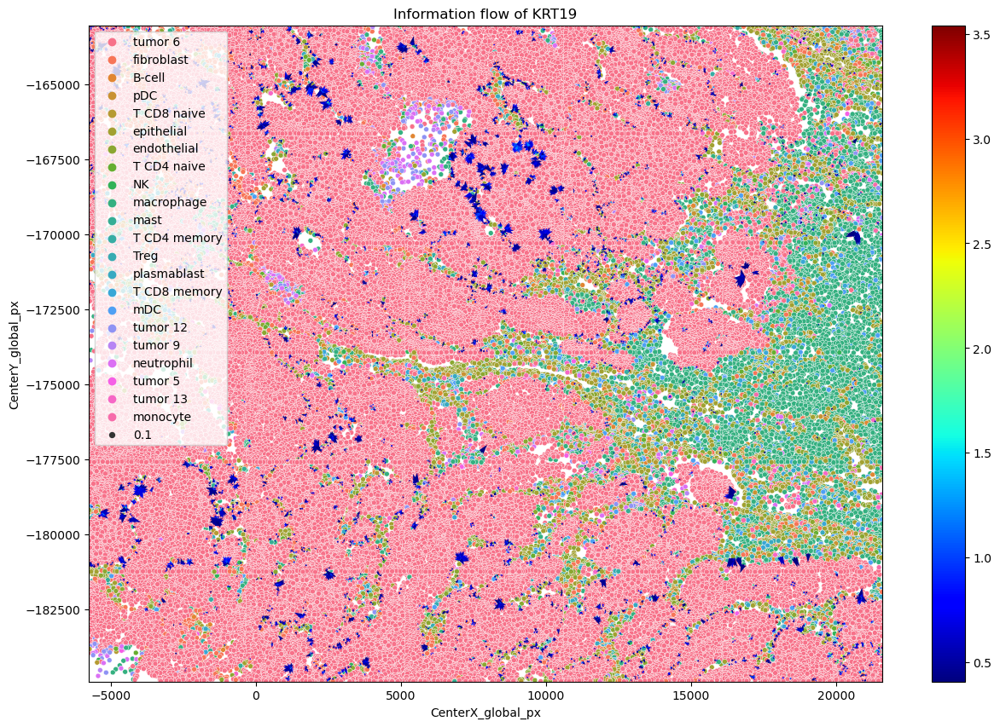

(445455, 960)


/tmp/ipykernel_4030282/4075740587.py:72: FutureWarning: Logical ops (and, or, xor) between Pandas objects and dtype-less sequences (e.g. list, tuple) are deprecated and will raise in a future version. Wrap the object in a Series, Index, or np.array before operating instead.
  adata=adata[(adata.obs['loss']<loss_threshold)&flags,:]
/tmp/ipykernel_4030282/862913190.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  from_x = from_x[flag]
/tmp/ipykernel_4030282/862913190.py:17: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  from_y = from_y[flag]
/tmp/ipykernel_4030282/862913190.py:18: FutureWarning: Series.__getitem__ t

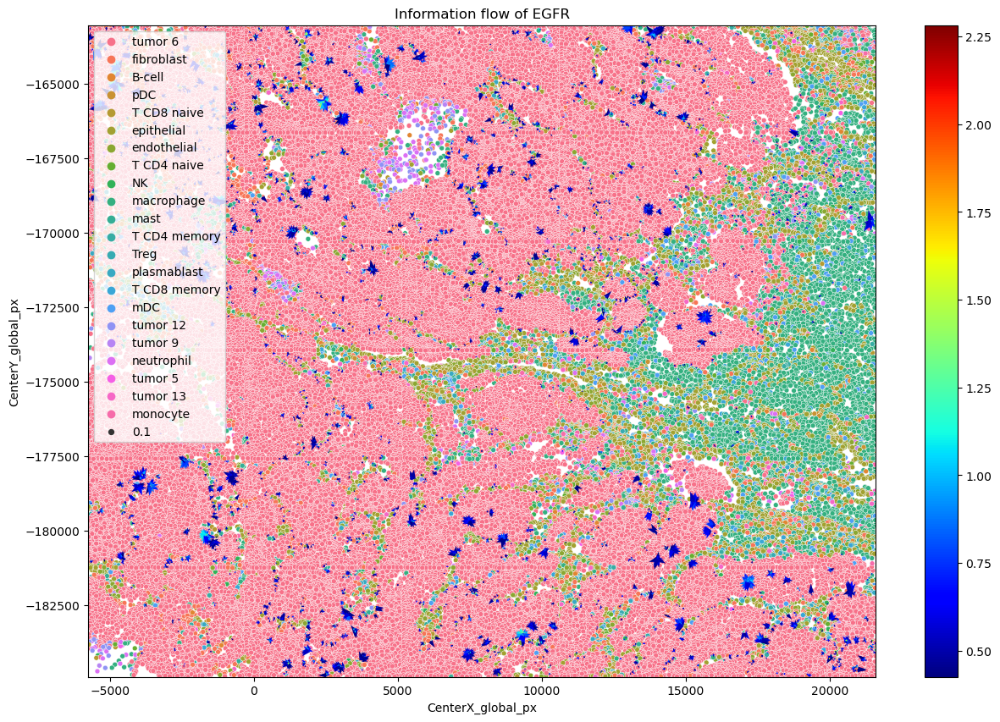

(445455, 960)


/tmp/ipykernel_4030282/4075740587.py:72: FutureWarning: Logical ops (and, or, xor) between Pandas objects and dtype-less sequences (e.g. list, tuple) are deprecated and will raise in a future version. Wrap the object in a Series, Index, or np.array before operating instead.
  adata=adata[(adata.obs['loss']<loss_threshold)&flags,:]
/tmp/ipykernel_4030282/862913190.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  from_x = from_x[flag]
/tmp/ipykernel_4030282/862913190.py:17: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  from_y = from_y[flag]
/tmp/ipykernel_4030282/862913190.py:18: FutureWarning: Series.__getitem__ t

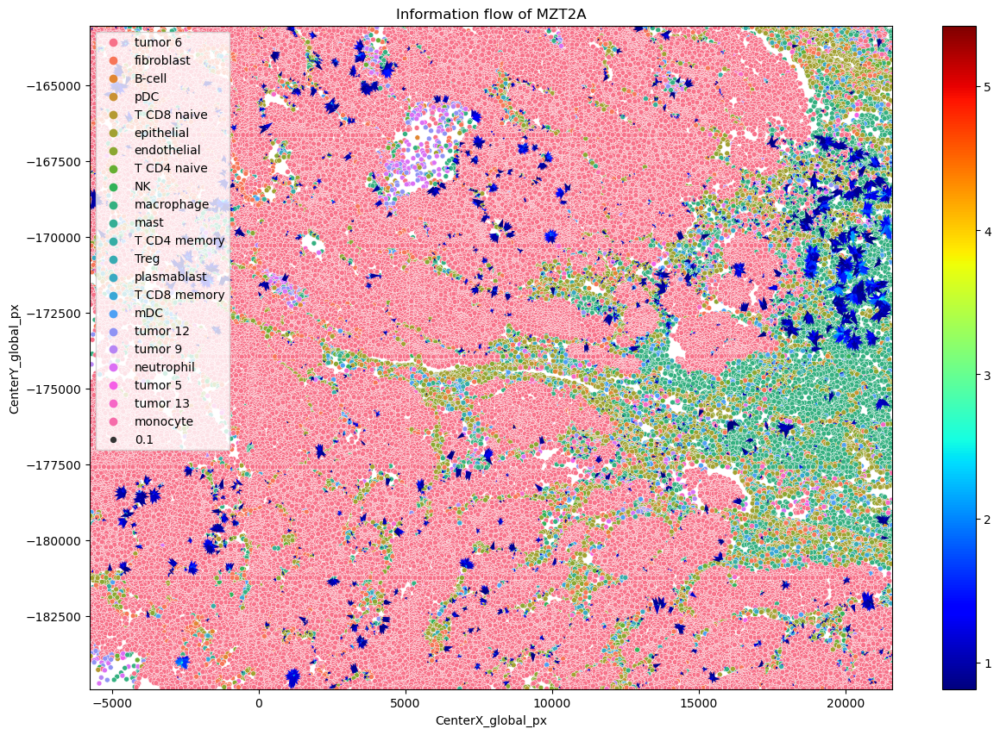

(445455, 960)


/tmp/ipykernel_4030282/4075740587.py:72: FutureWarning: Logical ops (and, or, xor) between Pandas objects and dtype-less sequences (e.g. list, tuple) are deprecated and will raise in a future version. Wrap the object in a Series, Index, or np.array before operating instead.
  adata=adata[(adata.obs['loss']<loss_threshold)&flags,:]
/tmp/ipykernel_4030282/862913190.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  from_x = from_x[flag]
/tmp/ipykernel_4030282/862913190.py:17: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  from_y = from_y[flag]
/tmp/ipykernel_4030282/862913190.py:18: FutureWarning: Series.__getitem__ t

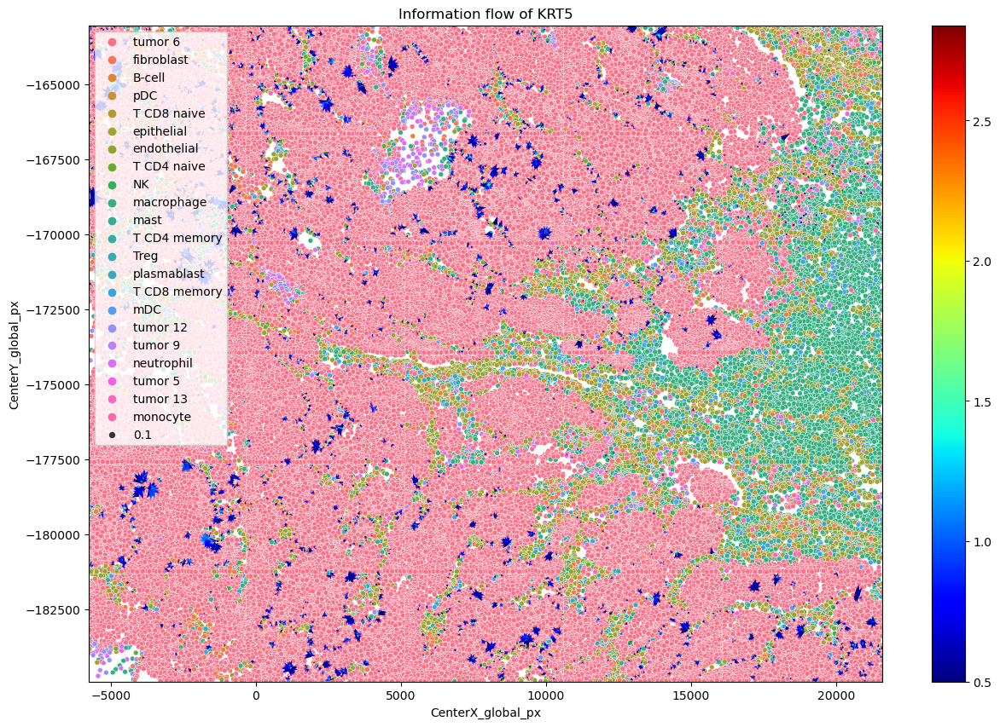

In [7]:
for genei in top_genes:
    plot_info_flow(sample=sample,df_position=df_position,idx=gene_list.index(genei),cutoff=0.05,title="Information flow of "+genei)